<a href="https://colab.research.google.com/github/Karmatica/video/blob/main/Top_Bottom_Txt_VIDEO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Modules

## install Modules

In [ ]:
!pip install m3u8
!pip install ffmpeg-python
!pip install blend-modes
!pip install moviepy


  Created wheel for blend-modes: filename=blend_modes-2.1.0-cp37-none-any.whl size=9548 sha256=601ccecb3a56f0fd850365db49f31429c11a0ca4edc7292f9558586a7e45f2b9
  Stored in directory: /root/.cache/pip/wheels/95/78/96/f8943447b04c319a6e4a7680df50cc47a70cc5a81657b15494
Successfully built blend-modes


In [ ]:
import re
import requests
from bs4 import BeautifulSoup
 
import PIL
from PIL import Image, ImageDraw, ImageFont,ImageFilter, ImageOps, ImageEnhance
from blend_modes import soft_light, darken_only

#from moviepy.editor import VideoFileClip, clips_array, vfx
from moviepy.editor import *
#from moviepy.editor import AudioFileClip, concatenate_audioclips

import os
import textwrap
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2

import json

from IPython.display import HTML
from base64 import b64encode

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2129920/45929032 bytes (4.6%)5529600/45929032 bytes (12.0%)9052160/45929032 bytes (19.7%)12304384/45929032 bytes (26.8%)15761408/45929032 bytes (34.3%)19210240/45929032 bytes (41.8%)22708224/45929032 bytes (49.4%)26034176/45929032 bytes (56.7%)29335552/45929032 bytes (63.9%)32743424/45929032 bytes (71.3%)35897344/45929032 bytes (78.2%)39157760/45929032 bytes (85.3%)

## Make Directories. Unzip Fonts.

In [ ]:
!mkdir /content/assets/
!mkdir /content/assets/fonts/
!mkdir /content/assets/image_assets/
!mkdir /content/assets/audio_assets/
!mkdir /content/assets/video_assets/

!rm /content/sample_data/README.md
!rm /content/sample_data/anscombe.json
!rm /content/sample_data/california_housing_test.csv
!rm /content/sample_data/california_housing_train.csv
!rm /content/sample_data/mnist_test.csv
!rm /content/sample_data/mnist_train_small.csv
!rmdir /content/sample_data

#!wget "https://filetransfer.io/data-package/SmGaUD8S/download"
# os.rename(r'/content/download',r'/content/assets/fonts/Poppins.zip') 	
# !unzip "/content/assets/fonts/Poppins.zip" -d /content/assets/fonts/


!git clone https://github.com/Karmatica/video2.git


#!unzip "/content/video2/Poppins.zip" -d /content/assets/fonts/


!unzip -q /content/video2/media.zip -d /content/assets/
!unzip -q /content/video2/Poppins.zip -d /content/assets/fonts/
!unzip -q /content/video2/outro.zip -d /content/assets/

!mv /content/assets/BG_master.png /content/assets/image_assets/
!mv /content/assets/outro.wav /content/assets/audio_assets/

!rm /content/video2/Poppins.zip
!rm /content/video2/media.zip
!rm /content/video2/outro.zip

Cloning into 'video2'...
remote: Enumerating objects: 40, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 40 (delta 12), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (40/40), done.


# **1. INPUT URL**
###Copy and paste URL from www.streamable.com

In [ ]:
print('Enter URL:')
page_url = input()

Enter URL:
https://streamable.com/34ye3v


# **2. INPUT TOP AND BOTTOM TEXT**
### Enter each line seperately. Up to **15** characters per line.

In [ ]:
#### TOP TEXT 
print("Please Enter Top Text Line 1: ")
msg_in = input()
print("Please Enter Top Text Line 2: ")
msg2_in = input()
#### BOTTOM TEXT
print("Please Enter Bottom Text Line 1: ")
msg3_in = input()
print("Please Enter Bottom Text Line 2: ")
msg4_in = input()

Please Enter Top Text Line 1: 
012345678912345
Please Enter Top Text Line 2: 
012345678912345
Please Enter Bottom Text Line 1: 
012345678912345
Please Enter Bottom Text Line 2: 
012345678912345


# Make Images

## Download video

In [ ]:

Streamable_URL = (page_url).replace("://", "://api.").replace(".com/", ".com/videos/")
print(Streamable_URL)

json_req = requests.get(Streamable_URL)
json_stream = json.loads(json_req.text)


json_sorted = sorted(json_stream.items())[:5]
json_out = (json_sorted[1][1]['mp4']['url'])
print(json_out)

r = requests.get(json_out)
with open("/content/assets/video_assets/streamableDL.mp4", "wb") as f:
    f.write(r.content)
    print("Video downloaded")

#### VIDOE LENGTH

video_length = len("/content/assets/video_assets/streamableDL.mp4")
print(video_length)
import moviepy.editor

# Converts into more readable format
def convert(seconds):
    hours = seconds // 3600
    seconds %= 3600
    mins = seconds // 60 *60
    seconds %= 60
    return hours, mins, seconds
# Create an object by passing the location as a string
video = moviepy.editor.VideoFileClip("/content/assets/video_assets/streamableDL.mp4")
# Contains the duration of the video in terms of seconds
video_duration = int(video.duration)
hours, mins, secs = convert(video_duration)

print("Hours:", hours)
print("Minutes:", mins)
print("Seconds:", secs)

total_secs = (mins + secs) +1
print("Total Seconds:", total_secs)

https://api.streamable.com/videos/34ye3v
https://cdn-cf-east.streamable.com/video/mp4/34ye3v.mp4?Expires=1614731400&Signature=Gko6ctZXLX26tPz~HCy-esFcqgecJIzsCBcxqbvTzD-6KZlw0wr6yiHBkbZY4W9iw-ml6r7wDBOQitK-wv7Np0vT0VzR6u0QZYLViPdPMdKBi9L4os6f80y6seQ012cmFwZ7Tf04SQCBfYYPzohR78D1VM9tESOUV6TWuS2ncZYfjtPqw1ZnpzrItvDSuVEBmvHD6NO3lfQpAwCcPyl7MlRUUxnJDchP5iqOtTFdONGipX-J90XnTFEyFXRlXRw1fv5uABpLodUD2TTH-A8D5QGC9AF92KlFZauB0S4ehzele8~gC67xau-xLRRrEabbryZ6T~~1HuLLIMIDM7eoig__&Key-Pair-Id=APKAIEYUVEN4EVB2OKEQ
Video downloaded
45
Hours: 0
Minutes: 60
Seconds: 23
Total Seconds: 84


### Make BG iamge

In [ ]:
# import math 

# w, h = 1080, 1080
# img = Image.new("RGBA", (w, h), color="#000000") 


# bg_image = "/content/assets/image_assets/bg.png"
# img.save(bg_image)

### Draw Text On Iamge

In [ ]:

W, H = (1080,1080)
msg  = msg_in.upper() #"TOP TEXT ONE"
msg2 = msg2_in.upper() #"THIS IS TOP TEXT LINE 2"

msg3  = msg3_in.upper() #"TOP TEXT ONE"
msg4 = msg4_in.upper() #"THIS IS TOP TEXT LINE 2"

# msg  = "TOP TEXT ONE"
# msg2 = "THIS IS TOP TEXT LINE 2"

# msg3  = "TOP TEXT ONE"
# msg4 = "THIS IS TOP TEXT LINE 2"


can_yellow = (246,234,59,255)


#im = Image.new("RGBA",(W,H),"black")
im = Image.open("/content/assets/image_assets/BG_master.png").convert('RGBA') 

shape = [(0, 236.25), (1079, 844.75)]




myFont = ImageFont.truetype('/content/assets/fonts/Poppins-ExtraBold.ttf', 90)



draw = ImageDraw.Draw(im)

#draw.rectangle(shape, outline=can_yellow)
#w, h = draw.textsize(msg)



w,h =myFont.getsize(msg)
w2,h2 =myFont.getsize(msg2)
top1_adj = 37
top2_adj = 122
draw.text((((W-w)/2),top1_adj), msg, font=myFont, anchor="mt", align='center', fill=can_yellow)
draw.text((((W-w2)/2),top2_adj), msg2, font=myFont, anchor="mt", align='center', fill=can_yellow)

w3,h3 =myFont.getsize(msg3)
w4,h4 =myFont.getsize(msg4)
bot3_adj = 834
bot4_adj = 917
draw.text((((W-w3)/2),bot3_adj), msg3, font=myFont, anchor="mt", align='center', fill="white")
draw.text((((W-w4)/2),bot4_adj), msg4, font=myFont, anchor="mt", align='center', fill="white")

print(w, h)



im.save("/content/assets/image_assets/1080new3.png", "PNG")


804 96


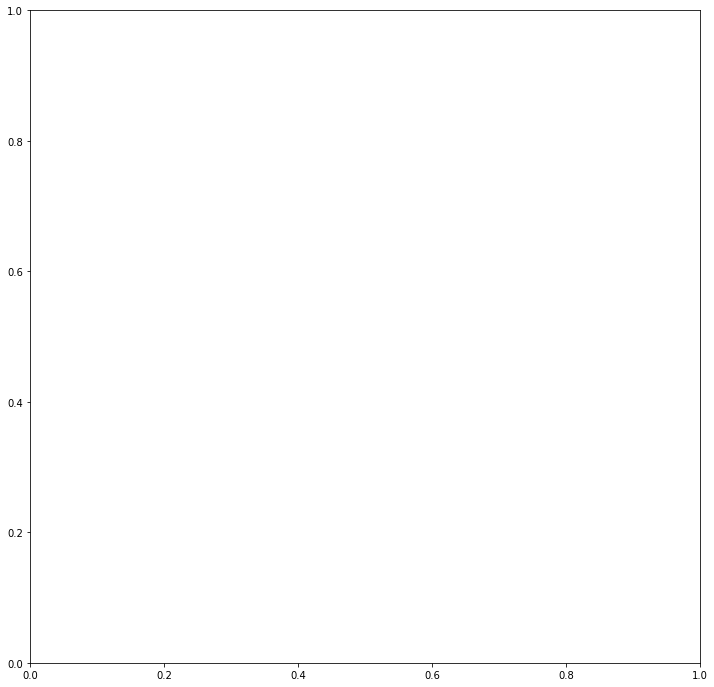

In [ ]:
#### DISPLAY BODY COPY
text_on_image = "/content/assets/image_assets/1080new3.png"
img1 = mpimg.imread(text_on_image)
rows = 1
columns = 1
fig = plt.figure(figsize=(12, 12))
fig.add_subplot(rows, columns, 1) 



# **3. DISPLAY IMAGE**

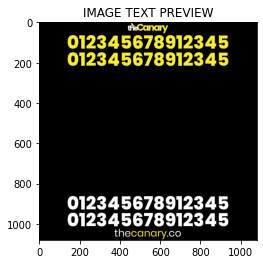

In [ ]:
plt.axis('on') 
plt.title("IMAGE TEXT PREVIEW") 
plt.imshow(img1) 

In [ ]:
print("Is image ok? Type (y) or (n)")
image_ok = input()

if image_ok == "y":
  pass




Is image ok? Type (y) or (n)
y


# Make Video

### Convert BG_Image To BG_Video

In [ ]:
from moviepy.editor import *



img_4_video = ["/content/assets/image_assets/1080new3.png"]


clips = [ImageClip(m).set_duration(total_secs).set_fps(25)
      for m in img_4_video]
concat_clip = concatenate_videoclips(clips, method="compose")

BG_video = "/content/assets/video_assets/text_bg.mp4"
concat_clip.write_videofile(BG_video, fps=25)

[MoviePy] >>>> Building video /content/assets/video_assets/text_bg.mp4
[MoviePy] Writing video /content/assets/video_assets/text_bg.mp4


100%|█████████▉| 2100/2101 [02:47<00:00, 12.53it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /content/assets/video_assets/text_bg.mp4 



## Composite Videos

In [ ]:
clip1 = VideoFileClip("/content/assets/video_assets/text_bg.mp4")

clip2 = VideoFileClip("/content/assets/video_assets/streamableDL.mp4").set_fps(25)


clip2 = clip2.resize(width=1080)
final_clip = CompositeVideoClip([clip1, clip2.set_position((0,236))])

final_clip.write_videofile("FINAL_comp_out.mp4", fps=25)


[MoviePy] >>>> Building video FINAL_comp_out.mp4
[MoviePy] Writing audio in FINAL_comp_outTEMP_MPY_wvf_snd.mp3


100%|██████████| 1851/1851 [00:02<00:00, 842.29it/s]

[MoviePy] Done.
[MoviePy] Writing video FINAL_comp_out.mp4



100%|█████████▉| 2100/2101 [03:19<00:00, 10.53it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: FINAL_comp_out.mp4 



# **4. DISPLAY VIDEO**

In [ ]:
#### DISPLAY VIDEO

mp4 = open('FINAL_comp_out.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""<style>video{padding-left:33px;}</style><video width=528 controls><source src="%s" type="video/mp4"></video>""" % data_url)

# **5. DOWNLOAD?**

In [ ]:
from google.colab import files
print('Would you like to download the video? Type "y" or "n"')
answerV = input()
if answerV == "y":
  files.download("/content/FINAL_comp_out.mp4")
   
else:
  pass

____
____


In [ ]:
!unzip /content/outro.zip -d /content/assets

In [ ]:
!git clone https://github.com/Karmatica/video2/blob/main/assets-pwp.zip

In [ ]:
!unzip -P 1234 content/assets-pwp.zip -d /content/assets

##### Make outro from image sequence

In [ ]:
import os
path_seq = "/content/assets/outro/"
#os.walk(path_seq)


# creating a Image sequence clip with fps = 1 #
clip_seq = ImageSequenceClip([path_seq +  '1.png', path_seq +  '2.png', path_seq +  '3.png', path_seq +  '4.png', path_seq +  '5.png', 
                              path_seq +  '6.png', path_seq +  '7.png', path_seq +  '8.png', path_seq +  '9.png', path_seq + '10.png', 
                              path_seq + '11.png', path_seq + '12.png', path_seq + '13.png', path_seq + '14.png', path_seq + '15.png', 
                              path_seq + '16.png', path_seq + '17.png', path_seq + '18.png', path_seq + '19.png', path_seq + '20.png', 
                              path_seq + '21.png', path_seq + '22.png', path_seq + '23.png', path_seq + '24.png', path_seq + '25.png', 
                              path_seq + '26.png', path_seq + '27.png', path_seq + '28.png', path_seq + '29.png', path_seq + '30.png', 
                              path_seq + '31.png', path_seq + '32.png', path_seq + '33.png', path_seq + '34.png', path_seq + '35.png', 
                              path_seq + '36.png', path_seq + '37.png', path_seq + '38.png', path_seq + '39.png', path_seq + '40.png', 
                              path_seq + '41.png', path_seq + '42.png', path_seq + '43.png', path_seq + '44.png', path_seq + '45.png', 
                              path_seq + '46.png', path_seq + '47.png', path_seq + '48.png', path_seq + '49.png', path_seq + '50.png', 
                              path_seq + '51.png', path_seq + '52.png', path_seq + '53.png', path_seq + '54.png', path_seq + '55.png', 
                              path_seq + '56.png', path_seq + '57.png', path_seq + '58.png', path_seq + '59.png', path_seq + '60.png', 
                              path_seq + '61.png', path_seq + '62.png', path_seq + '63.png', path_seq + '64.png', path_seq + '65.png', 
                              path_seq + '66.png', path_seq + '67.png', path_seq + '68.png', path_seq + '69.png', path_seq + '70.png', 
                              path_seq + '71.png', path_seq + '72.png', path_seq + '73.png', path_seq + '74.png', path_seq + '75.png', 
                              path_seq + '76.png', path_seq + '77.png', path_seq + '78.png', path_seq + '79.png', path_seq + '80.png', 
                              path_seq + '81.png', path_seq + '82.png', path_seq + '83.png', path_seq + '84.png', path_seq + '85.png', 
                              path_seq + '86.png', path_seq + '87.png', path_seq + '88.png', path_seq + '89.png', path_seq + '90.png', 
                              path_seq + '91.png', path_seq + '92.png', path_seq + '93.png', path_seq + '94.png', path_seq + '95.png', 
                              path_seq + '96.png', path_seq + '97.png', path_seq + '98.png', path_seq + '99.png', path_seq + '100.png'], fps = 25) 

#outro_wav = AudioFileClip("/content/assets/audio_assets/outro.mp3")

#final_outro_comp = CompositeVideoClip([clip_seq, outro_wav])

clip_seq.write_videofile("/content/assets/video_assets/outro.mp4", fps=25)


#### Join Outro Audio And Video

In [ ]:
# videoclip = VideoFileClip("/content/assets/video_assets/outro.mp4")
# audioclip = AudioFileClip("/content/assets/audio_assets/outro.mp3")

# new_audioclip = CompositeAudioClip([audioclip])
# videoclip.audio = new_audioclip
# videoclip.write_videofile("new_filename.mp4")

In [ ]:
#### DISPLAY VIDEO

mp4 = open('/content/FINAL_outro.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""<style>video{padding-left:33px;}</style><video width=528 controls><source src="%s" type="video/mp4"></video>""" % data_url)

In [ ]:
# Import everything needed to edit video clips 
from moviepy.editor import *






# loading video dsa gfg intro video 
clip = VideoFileClip("/content/FINAL_comp_out.mp4") 
  
# getting subclip as video is large 
#clip1 = clip.subclip(0, 5) 
  
  
# loading video gfg 
clip2 = VideoFileClip(clip_seq) 
  
# getting subclip  
#clip2 = clipx.subclip(0, 5) 
  
# clip list 
clips = [clip1, clip2] 
  
# concatinating both the clips 
final = concatenate_videoclips(clips) 
  
# showing final clip 
#final.ipython_display(width = 480) 

final.write_videofile("FINAL_comp_out_con.mp4", fps=25)